# 2 EDA
Exploratory Data Analysis requires us to analyze the data.

In most scenarios, graphs will be useful to deduce patterns and make predictions on how we expect our predictions to behave.

In [1]:
# Custom DataLoader
from DataLoader import DataLoader

# Graph
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

# Scaling
from sklearn.preprocessing import MinMaxScaler, StandardScaler;

In [2]:
dataLoader = DataLoader('Dataset 6 - Music Dataset/music.csv', True, True)
df = dataLoader.dict_df['feature_eng'].copy()

In [3]:
df.head()

,Artist Name,Track Name,Popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,...,HasSung_1,HasSung_2,HasSung_3,HasSung_4,HasSung_5,HasSung_6,HasSung_7,HasSung_8,HasSung_9,HasSung_10
0,Bruno Mars,That's What I Like (feat. Gucci Mane),60.0,0.854,0.564,1.0,-4.964,1,0.0485,0.017100,...,0,0,0,0,1,0,0,0,1,0
1,Boston,Hitch a Ride,54.0,0.382,0.814,3.0,-7.230,1,0.0406,0.001100,...,0,0,0,0,0,0,0,0,0,1
2,The Raincoats,No Side to Fall In,35.0,0.434,0.614,6.0,-8.334,1,0.0525,0.486000,...,1,0,0,0,0,1,0,0,0,0
3,Deno,Lingo (feat. J.I & Chunkz),66.0,0.853,0.597,10.0,-6.528,0,0.0555,0.021200,...,0,0,0,0,1,0,0,0,0,0
4,Red Hot Chili Peppers,Nobody Weird Like Me - Remastered,53.0,0.167,0.975,2.0,-4.279,1,0.2160,0.000169,...,0,0,0,0,0,0,0,0,0,1


# 2.1 Feature Selection
Continue the Feature selection like in preprocessing but look for distinguishable features.


### Violin plots allow us to visualize both the range (box plot) and density (kde). 
#### Check if the features are distinguishably different per `Class`

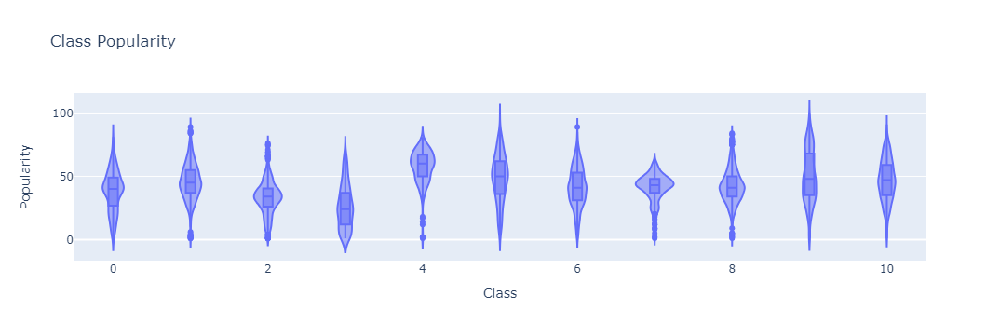

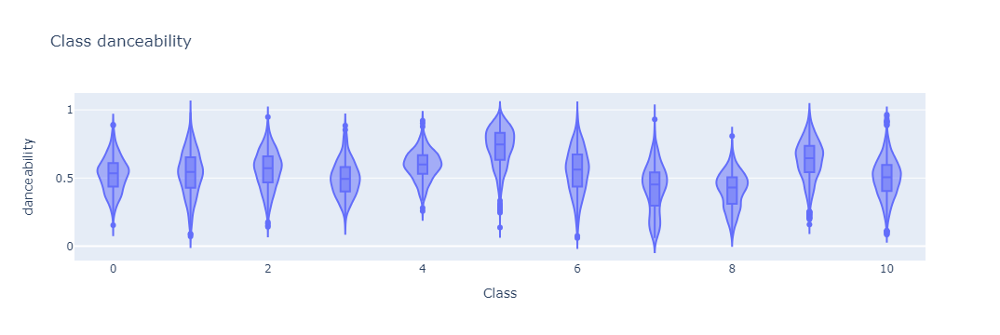

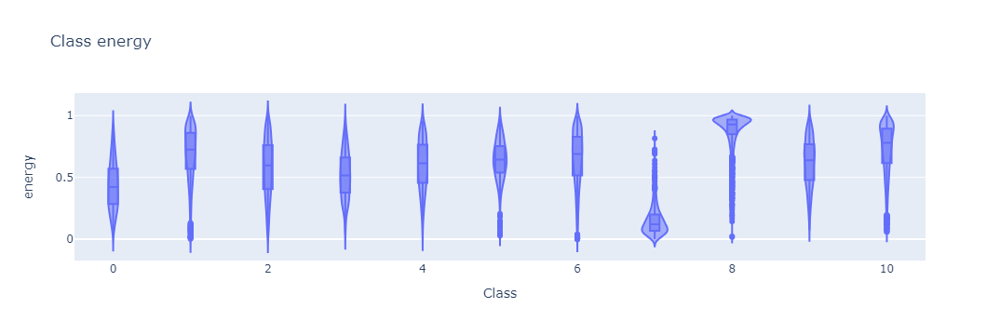

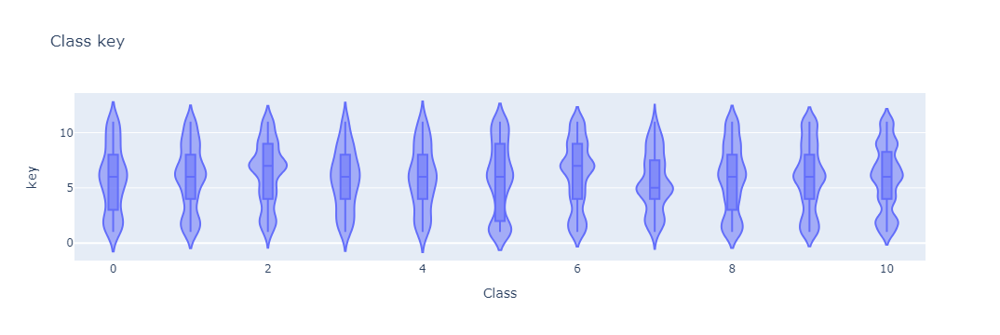

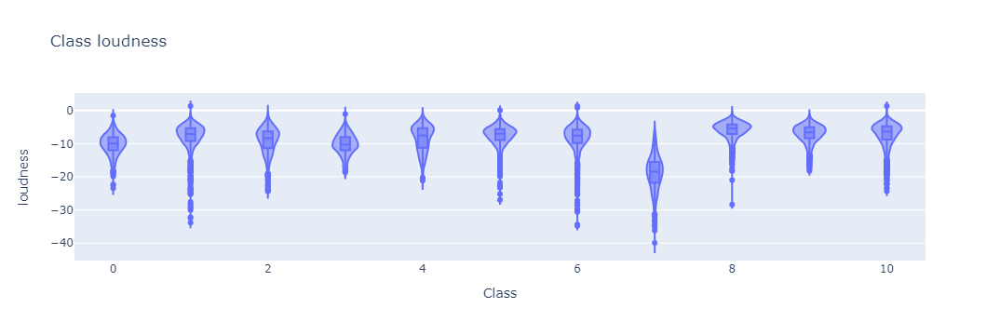

...

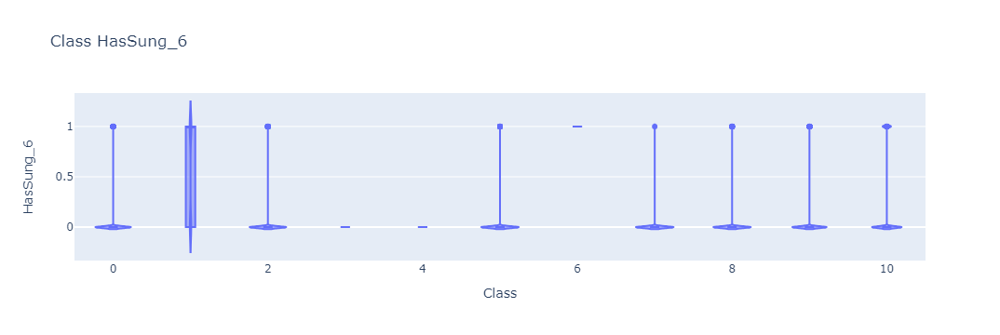

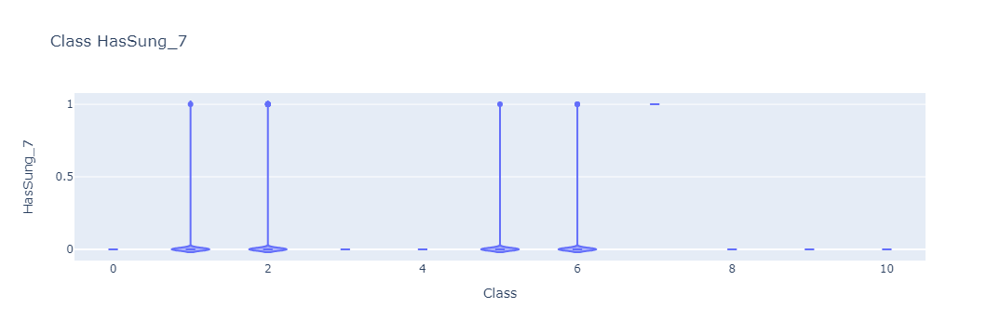

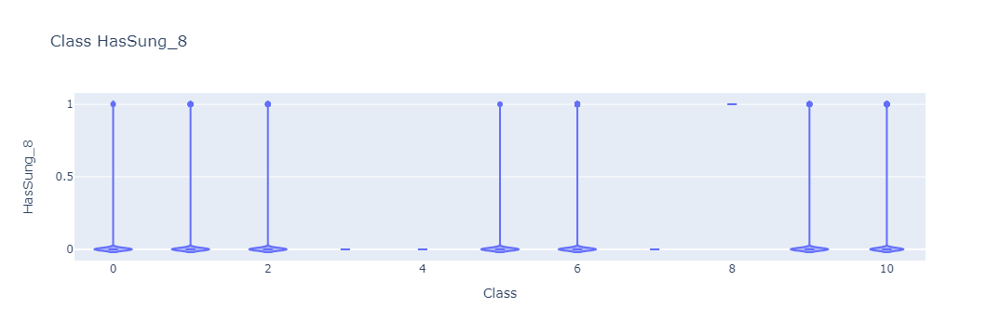

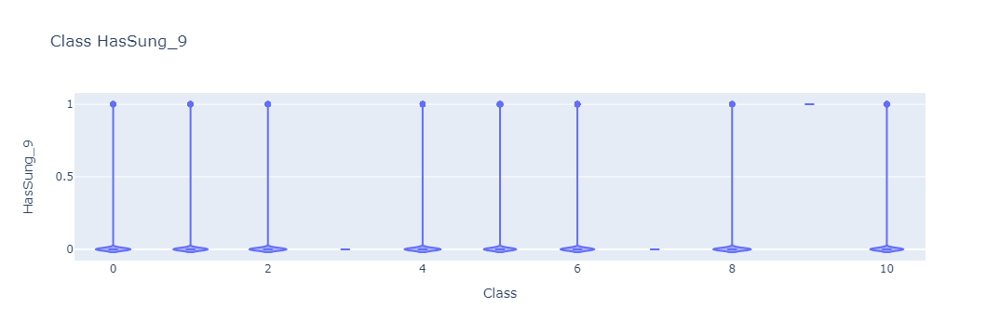

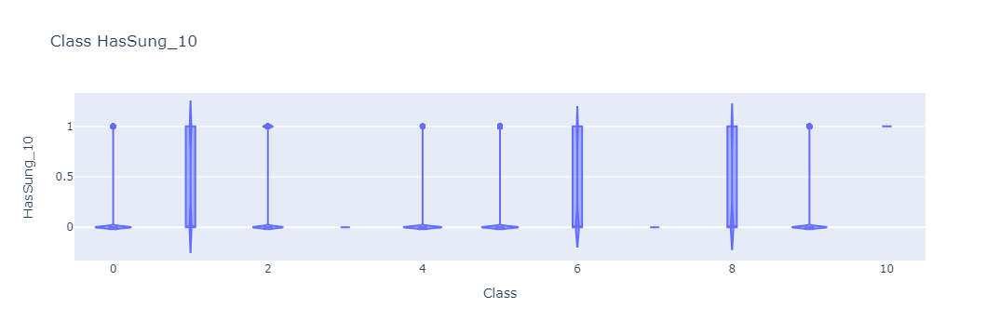

In [4]:
for col in df.columns[2:].drop('Class'):
    plot = px.violin(df[['Class', col]], y=col, x='Class', box=True, title='Class ' + col)
    plot.show()

## Observations

### Binary features aren't distinguishably different.

Most records were overwhelmingly `0` across all Classes
<img src='Graphs/EDA Is_Collab.png'>
<img src='Graphs/EDA Is_Remix.png'>

### Time signature also showed identical distributions (except Class 4)
Time signature `4` had the most occurences.

<img src='Graphs/EDA Time_Signature.png'>

### Valence and Key share some similar graphs.
<li> Valence was similar in Classes `2` to `4`
<li> Valence was similar in Classes `1` and `6`</li>
<li>Key was similar in Classes `1` and `9`</li>
<li>Key was similar in Classes `3` and `6`</li>

<img src='Graphs/EDA Valence.png'>
<img src='Graphs/EDA Key.png'>

### Drop the features that are String type and identical across Classes.
#### Although the Valence and Key are similar in some Classes, we can  try keeping these features first to compare the difference.

In [5]:
# Strings
cols_to_drop = ['Artist Name', 'Track Name']

# Binaries 
cols_to_drop += list(df.columns[df.columns.get_loc('Class') + 1:])

# Time signature 
cols_to_drop.append('time_signature')

cols_to_drop

df = df.drop(columns=cols_to_drop)

# 2.2 Feature Scaling

### Converting time
Time can be converted to a more perceivable value of seconds than ms.

In [6]:
df['duration_in min/ms'] = df['duration_in min/ms'] / 1000
df.rename(columns={'duration_in min/ms' : 'duration (seconds)'}, inplace=True)

<Axes: >

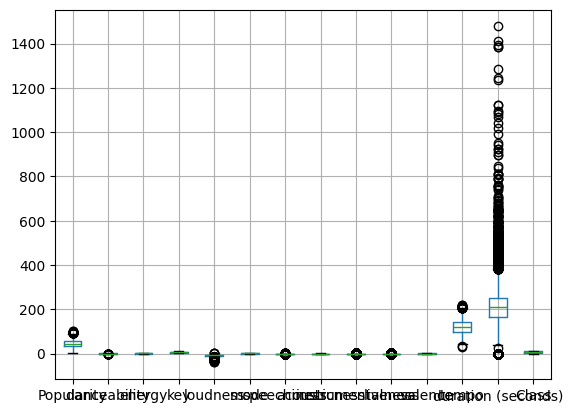

In [7]:
df.boxplot()

### The features could still use scaling.
Loudness is the only negative feature.<br>
Popularity, Duration and Tempo exceed the usual max range of 1.

It should be noted that numerous outliers are present.

## Min Max Scaling

In [8]:
df_normalize = df.copy()

cols_To_Scale = df_normalize.columns[:-1]
df_normalize[cols_To_Scale] = MinMaxScaler().fit_transform(df_normalize[cols_To_Scale])

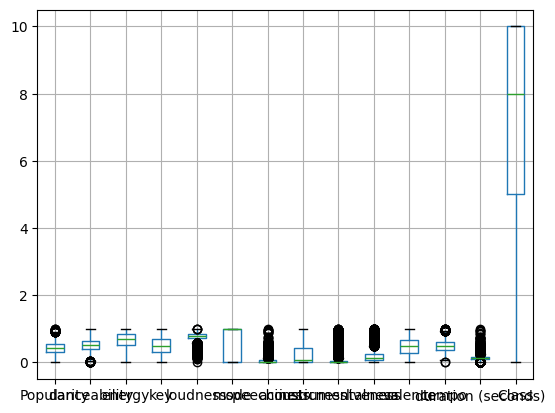

In [9]:
df_normalize.boxplot()
plt.show()

## Standardization Scaling

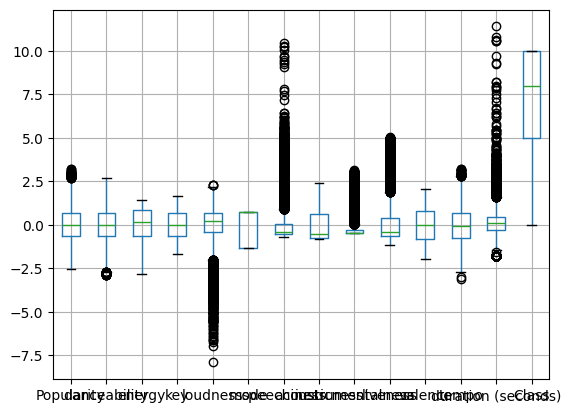

In [10]:
df_standardize = df.copy()
df_standardize[cols_To_Scale] = StandardScaler().fit_transform(df_standardize[cols_To_Scale])

df_standardize.boxplot()
plt.show()

### Scaling Effect

Overall, it's apparent that scaling helps limit the ranges.

Instead of `duration` reaching > 1400, we see it limited to around 10 for Standardization and 1 for Normalization.

However the outliers are still troublesome, hence Normalization may produce inaccurate results. Nonetheless testing the raw, normalized, and standardized should show a comparisson. 

# 2.3 Feature Relationships
One more analysis we'd like to see is for feature correlations.

Some models may perform poorly on MultiCollinerality hence consider dropping those feature and retest depending on the model.

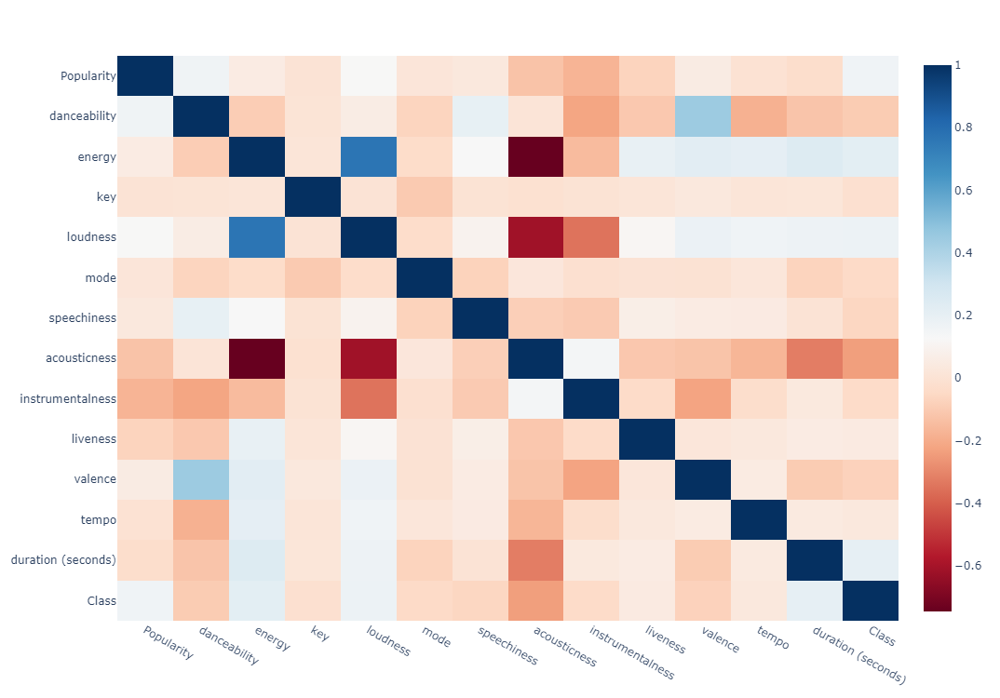

In [11]:
px.imshow(df.corr(), height=750, aspect='auto', color_continuous_scale=px.colors.diverging.RdBu)